In [2]:
from poliastro.iod.izzo import lambert

def lambert_multirev(a, b, revs=0):
    # Get initial algorithm conditions
    k = a.attractor.k
    r_i = a.r
    r_f = b.r

    # Time of flight is solved by subtracting both orbit epochs
    tof = b.epoch - a.epoch

    # Compute all possible solutions to the Lambert transfer
    try:
        return [(v_i - a.v, b.v - v_f) for v_i, v_f in lambert(k, r_i, r_f, tof, M=revs)]
    except ValueError:
        return lambert_multirev(a, b, revs=revs - 1)

In [5]:
from astropy.time import Time
from pathfinder.modules import Ephemeris
from poliastro.util import time_range
import torch

eph = Ephemeris('Mars')
t = torch.tensor(time_range(Time.now(), end=Time.now() + 50.0).mjd, requires_grad=True)
torch.autograd.gradcheck(eph, t)

True

In [12]:
from astropy.coordinates import get_body_barycentric_posvel

r1, v1 = get_body_barycentric_posvel('sun', Time.now())
r2, v2 = get_body_barycentric_posvel('sun', Time.now() + 1.0)

In [13]:
v1.get_xyz(), v2.get_xyz()

(<Quantity [-4.89111696e-06, -7.18191651e-06, -2.91817030e-06] AU / d>,
 <Quantity [-4.88091129e-06, -7.18965448e-06, -2.92173561e-06] AU / d>)

In [1]:
from astropy.units import Unit
from poliastro.bodies import Earth, Mars
from poliastro.twobody import Orbit
from pathfinder.problems import LowThrustTransfer

problem = LowThrustTransfer(
    Earth,
    Mars,
    3000.0 * Unit('s'),
    0.3 * Unit('N'),
    1000.0 * Unit('kg'),
    dry_mass=200.0 * Unit('kg')
)
sol = problem.compute()
# sol = problem.forward(300.0, bounded=True, alpha=0.5)

Approximating sphere of influence of Earth as 0.00936 AU (1400640.57 km)
t_prime=0.0
t_prime=3.937169750630448e-05
t_prime=0.0007874339501260895
t_prime=0.0011811509251891342
t_prime=0.003149735800504358
t_prime=0.003499706445004842
t_prime=0.0039371697506304475
t_prime=0.0039371697506304475
t_prime=0.008897390452751116
t_prime=0.01137750080381145
t_prime=0.023778052559113125
t_prime=0.025982595093388974
t_prime=0.028738273261233793
t_prime=0.028738273261233793
t_prime=0.03652352873680287
t_prime=0.040416156474587406
t_prime=0.05987929516351009
t_prime=0.06333940870820745
t_prime=0.06766455063907917
t_prime=0.06766455063907917
t_prime=0.07504330498913266
t_prime=0.0787326821641594
t_prime=0.09717956803929313
t_prime=0.10045901441709468
t_prime=0.10455832238934662
t_prime=0.10455832238934662
t_prime=0.1122749590502972
t_prime=0.11613327738077249
t_prime=0.13542486903314896
t_prime=0.13885448532690475
t_prime=0.14314150569409953
t_prime=0.14314150569409953
t_prime=0.1550727697815425
t_pr

In [10]:
import jax
dir(jax)

['__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '__path__',
 '__spec__',
 'numpy']

In [9]:
from astropy.time import Time
from functools import partial
from jax import custom_vjp
from numpy.lib.recfunctions import structured_to_unstructured
from numpy.typing import ArrayLike
from typing import Tuple
import erfa
import numpy as np
import jax
import jax.numpy as jnp


JD_TO_MJD = 2400000.5
MU_SUN = -0.00029591220819207774     # Gravitational parameter of the Sun in units AU**3/days**2
PLAN94_BODY_NAME_TO_PLANET_INDEX = {
    'mercury': 1,
    'venus': 2,
    'earth-moon-barycenter': 3,
    'mars': 4,
    'jupiter': 5,
    'saturn': 6,
    'uranus': 7,
    'neptune': 8,
}


# Called under the hood by the public get_barycentric_posvel() function
def _get_helio_and_bary_posvel(body: str, t: ArrayLike) -> Tuple[ArrayLike, ArrayLike]:
    plan94_idx = PLAN94_BODY_NAME_TO_PLANET_INDEX[body.lower()]

    # Compute the barycentric state vector of the Sun by subtracting the
    # heliocentric & barycentric state vectors of the Earth
    earth_rv_helio, earth_rv_bary = erfa.epv00(t, JD_TO_MJD)
    sun_rv_bary = erfa.pvmpv(earth_rv_bary, earth_rv_helio)

    # Convert the heliocentric state vector for this body into barycentric
    # coordinates by simply adding the barycentric state vector of the Sun
    body_rv_helio = erfa.plan94(t, JD_TO_MJD, plan94_idx)
    body_rv_bary = erfa.pvppv(body_rv_helio, sun_rv_bary)
    return body_rv_helio, body_rv_bary


@custom_vjp(nondiff_argnums=(0,))
def get_barycentric_posvel(body: str, t) -> ArrayLike:
     _, body_rv_bary = _get_helio_and_bary_posvel(body, t)
     return structured_to_unstructured(body_rv_bary)

def fwd_get_barycentric_posvel(body: str, t) -> Tuple[ArrayLike, Tuple[ArrayLike, ArrayLike]]:
    body_rv_helio, body_rv_bary = _get_helio_and_bary_posvel(body, t)

    # Approximate the acceleration vector for this body using Newton's law
    # of gravitation, considering only the Sun's mass and no other masses.
    body_r_helio = body_rv_helio['p']
    body_acc = MU_SUN * body_r_helio / jnp.linalg.norm(body_r_helio, axis=-1, keepdims=True) ** 3

    body_v_bary = body_rv_bary['v']
    return structured_to_unstructured(body_rv_bary), (body_v_bary, body_acc)

def bwd_get_barycentric_posvel(residual, in_grad):
    grad_r, grad_v = in_grad[:3], in_grad[3:]
    body_v_bary, body_acc = residual
    return jnp.sum(grad_r * body_v_bary) + jnp.sum(grad_v * body_acc)

get_barycentric_posvel.defvjp(fwd_get_barycentric_posvel, bwd_get_barycentric_posvel)

get_barycentric_posvel('venus', Time.now().mjd)

ImportError: cannot import name 'custom_vjp' from 'jax' (unknown location)

In [89]:
body_acc.shape

(100, 3)

In [86]:
body_rv_helio['p'].shape

(100, 3)

In [72]:
from astropy.constants import GM_sun

Time.now().jd - Time.now().mjd

2400000.4999999874

In [74]:
from astropy.coordinates import get_body_barycentric_posvel

get_body_barycentric_posvel('venus', Time.now())

(<CartesianRepresentation (x, y, z) in AU
     (-0.19895546, -0.63922819, -0.27544572)>,
 <CartesianRepresentation (x, y, z) in AU / d
     (0.01937313, -0.00448943, -0.00324579)>)

In [7]:
v.dtype

dtype('float64')

In [1]:
from astropy.time import Time
from astropy.units import Unit
from poliastro.bodies import Earth, Mars
from pathfinder.modules import Control
import torch

control = Control(
    Earth,
    Mars,
    3000.0 * Unit('s'),
    0.3 * Unit('N'),
    1000.0 * Unit('kg'),
    200.0 * Unit('kg'),
    Time.now().mjd,
    250.0
)
control.propagate(num_nodes=2)
# y0 = (
#     # State and co-state are both 7D state vectors of the form (position, velocity, mass)
#     torch.cat([*control.source(control.t0), torch.tensor([1.0])]).detach(),
#     control.costate0.data
# )
# with torch.no_grad():
#     control.forward(0.0, y0)

t_hat=tensor(0., dtype=torch.float64)
t_hat=tensor(0.0002, dtype=torch.float64)
t_hat=tensor(0.0003, dtype=torch.float64)
t_hat=tensor(0.0008, dtype=torch.float64)
t_hat=tensor(0.0009, dtype=torch.float64)
t_hat=tensor(0.0010, dtype=torch.float64)
t_hat=tensor(0.0010, dtype=torch.float64)
t_hat=tensor(5.3704e-05, dtype=torch.float64)
t_hat=tensor(8.0556e-05, dtype=torch.float64)
t_hat=tensor(0.0002, dtype=torch.float64)
t_hat=tensor(0.0002, dtype=torch.float64)
t_hat=tensor(0.0003, dtype=torch.float64)
t_hat=tensor(0.0003, dtype=torch.float64)
t_hat=tensor(1.7274e-05, dtype=torch.float64)
t_hat=tensor(2.5911e-05, dtype=torch.float64)
t_hat=tensor(6.9097e-05, dtype=torch.float64)
t_hat=tensor(7.6775e-05, dtype=torch.float64)
t_hat=tensor(8.6372e-05, dtype=torch.float64)
t_hat=tensor(8.6372e-05, dtype=torch.float64)
t_hat=tensor(0.0001, dtype=torch.float64)
t_hat=tensor(0.0001, dtype=torch.float64)
t_hat=tensor(0.0002, dtype=torch.float64)
t_hat=tensor(0.0002, dtype=torch.float64)
t_hat=

KeyboardInterrupt: 

In [4]:
from torch import enable_grad

<Quantity 1.01098962 AU>

In [48]:
torch.autograd.gradcheck(asteroid_rv, t)

True

In [ ]:
min(np.linalg.norm(dv1) for dv1, dv2 in lambert_multirev(orbit1, orbit2.propagate(5000.0), revs=10))

<Quantity 3.60606698 km / s>

In [14]:
from itertools import product
from poliastro.maneuver import Maneuver
import matplotlib.pyplot as plt
import numpy as np

days = Unit('d')
period = orbit1.period.to('d').value

@np.vectorize
def lambert_dv(t_prime: float, tof: float):
    t = t_prime * days
    
    launch = orbit1.propagate(t)
    arrival = orbit2.propagate(t + tof * days)

    revs = int(np.floor(tof / period))
    dv = min(np.linalg.norm(dv1) for dv1, dv2 in lambert_multirev(launch, arrival, revs=revs))
    # dv, _ = min(
    #     (
    #         (np.linalg.norm(dv1), np.linalg.norm(dv2))
    #         for dv1, dv2 in lambert_multirev(launch, arrival, revs=revs)
    #     ),
    #     key=lambda x: np.linalg.norm(x[0])
    # )
    return dv.value

X = np.arange(0.0, 1000.0, 5.0)
Y = np.arange(200.0, 7300.0, 5.0)

# points = [lambert_dv(x, y) for x, y in product(X, Y)]


X, Y = np.meshgrid(X, Y)
Z = lambert_dv(X, Y)

Text(0, 0.5, 'Impact velocity (km/s)')

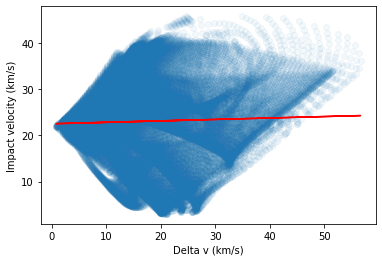

In [151]:
x = np.array([x for x, y in points])
y = np.array([y for x, y in points])
plt.scatter(x, y, alpha=0.05)

m, b = np.polyfit(x, y, 1)
plt.plot(x, m * x + b, c='red')
plt.xlabel('Delta v (km/s)')
plt.ylabel('Impact velocity (km/s)')

In [15]:
import plotly.graph_objects as go

fig = go.Figure(
    data=[go.Surface(x=X, y=Y, z=Z)]
)
fig.update_layout(
    # title='Delta v from 2010 YD3 to Mars (km/s)',
    title='Delta v (km/s)',
    height=1000,
    width=1000,
    margin=dict(l=10, r=10, t=40, b=10),
    scene=dict(
        xaxis=dict(title='Launch date (days from now)'),
        yaxis=dict(title='Time of flight (days)'),
        # zaxis=dict(title='Delta v (km/s)')
        zaxis=dict(title='Delta v (km/s)')
    )
)
fig.show()

In [19]:
[np.linalg.norm(x) for y, x in lambert_multirev(orbit1.propagate(1195.0), orbit2.propagate(4000.0), revs=5)]

[<Quantity 16.04754556 km / s>, <Quantity 8.68371014 km / s>]

In [16]:
x, y = divmod(np.argmin(Z), Z.shape[1])
x * 5, 200 + y * 5

(405, 640)

In [132]:
Z[x, y]

2.0733587070903883

In [17]:
from poliastro.twobody import Orbit
asteroid = Orbit.from_sbdb('2010 YD')
asteroid 

2.6178255647156474

In [4]:
from astropy.time import Time
from astropy.units import Unit
from poliastro.ephem import Ephem
from poliastro.frames import Planes
from poliastro.twobody import Orbit
from poliastro.maneuver import Maneuver
from poliastro.plotting import OrbitPlotter3D

launch = Time(Time.now(), scale='tdb')
arrival = launch + 500.0

asteroid = Orbit.from_sbdb('2010 YD')  # .change_plane(Planes.EARTH_EQUATOR)
mars0 = Orbit.from_ephem(Sun, Ephem.from_body(Mars, launch), launch)
mars_f = mars0.propagate(arrival)

plotter = OrbitPlotter3D(dark=True)
plotter.plot(asteroid, label='2010 YD at launch')
plotter.plot(mars0, label='Mars at launch')
plotter.plot(mars_f, label='Mars at arrival')

transfer0, transfer_f = asteroid.apply_maneuver(Maneuver.lambert(asteroid, mars_f), intermediate=True)
plotter.plot_trajectory(transfer0.sample(max_anomaly=mars_f.nu), color='gray', label='Transfer')

NotImplementedError: Frames for orbits around custom bodies are not yet supported

In [5]:
Orbit.from_sbdb('2010 YD')

1 x 3 AU x 0.4 deg orbit around Sun (☉) at epoch 2459396.5008007423 (TDB)

In [33]:
from pathfinder import search_asteroids_by_name

search_asteroids_by_name('2010 YD')

,full_name,e,a,i,om,w,ma,sigma_e,sigma_a,sigma_i,sigma_om,sigma_w,sigma_ma,diameter,diameter_sigma,epoch,spec_T,spec_B
spkid,,,,,,,,,,,,,,,,,,
3554416,(2010 YD),0.5379,2.043,0.44,94.13,39.72,206.53,5.300000e-04,2.600000e-03,0.000230,0.016000,0.019000,2.500000,0.026,0.01,2459396.5,<NA>,<NA>
3555045,(2010 YD3),0.5671,2.584,24.50,252.15,219.44,195.51,2.500000e-07,2.200000e-07,0.000041,0.000072,0.000076,0.000098,0.755,0.25,2459396.5,<NA>,<NA>


In [28]:
orbit0.plane

<Planes.EARTH_ECLIPTIC: 'Earth mean Ecliptic and Equinox of epoch (J2000.0)'>

In [17]:
udp.pretty(pop.champion_x)

Total DV (m/s):  5870.74938557078
Dvs (m/s):  [3346.877824575315, 2523.8715609954643]
Tofs (days):  [342.0794560236768]


In [6]:
from pathfinder import get_asteroid_info, get_mars_crossers

info = get_asteroid_info()

Loading cached asteroid info from 'jpl-asteriod-info.csv'


In [11]:
import pandas as pd
import requests

kepler = ['e', 'a', 'i', 'om', 'w', 'ma']
kepler_sigma = ['sigma_' + x for x in kepler]
physical = ['diameter', 'diameter_sigma', 'epoch', 'rot_per']

numeric_cols = kepler + kepler_sigma + physical
string_cols = ['full_name', 'spec_T', 'spec_B']
col_names = ['spkid'] + numeric_cols

response = requests.get('https://ssd-api.jpl.nasa.gov/sbdb_query.api', params={
    'sb-kind': 'a',
    
    # Get only the asteroids with a known diameter value
    'sb-cdata': r"""
    {
        "AND": ["diameter|DF"]
    }
    """,
    'fields': ','.join(col_names)
})
response.raise_for_status()     # Assert that status == 200

dict_response = response.json()
_asteroid_info = pd.DataFrame(dict_response['data'], columns=dict_response['fields']).infer_objects()

# _asteroid_info.spkid = _asteroid_info.spkid.astype('int')
_asteroid_info.set_index('spkid', inplace=True)


In [12]:
_asteroid_info

,e,a,i,om,w,ma,sigma_e,sigma_a,sigma_i,sigma_om,sigma_w,sigma_ma,diameter,diameter_sigma,epoch,rot_per
spkid,,,,,,,,,,,,,,,,
2000001,0.0784,2.766,10.59,80.27,73.74,247.55,4.8e-12,1.0e-11,4.6e-09,6.2e-08,6.6e-08,7.0e-09,939.4,0.20,2459396.5,9.074170
2000002,0.2298,2.774,34.90,172.92,310.44,229.23,3.2e-08,4.6e-09,3.5e-06,6.2e-06,9.1e-06,8.9e-06,545,18.00,2459396.5,7.8132
2000003,0.2570,2.668,12.99,169.85,248.00,215.09,3.0e-08,3.3e-09,3.2e-06,1.7e-05,1.8e-05,8.2e-06,246.596,10.59,2459396.5,7.210
2000004,0.0884,2.362,7.14,103.81,151.02,311.69,2.3e-10,1.5e-09,2.2e-07,3.9e-07,1.8e-07,1.4e-06,525.4,0.20,2459396.5,5.34212766
2000005,0.1906,2.574,5.37,141.57,358.66,112.38,2.4e-08,3.5e-09,2.7e-06,2.9e-05,3.0e-05,8.2e-06,106.699,3.14,2459396.5,16.806
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3839175,0.2448,2.744,13.47,302.97,253.65,144.38,1.2e-05,4.0e-07,1.3e-04,4.3e-05,2.3e-03,1.0e-03,1.870,0.20,2459396.5,None
3839314,0.2971,2.715,16.57,122.96,297.42,230.86,9.0e-08,4.6e-08,1.2e-05,1.9e-05,2.9e-05,1.9e-05,2.182,0.28,2459396.5,None
3839472,0.2430,2.679,16.72,38.98,26.09,237.57,3.2e-07,5.0e-08,7.6e-06,4.1e-05,4.6e-05,3.5e-05,1.688,0.48,2459396.5,None


In [14]:
len(_asteroid_info) - _asteroid_info['rot_per'].isna().sum()

18957

In [5]:
from astropy.units import Unit

(1.0 * Unit('d')).to('s')

<Quantity 86400. s>

In [2]:
import numpy as np
np.arccos(np.sum(sol.u * sol.v, axis=0) / (np.linalg.norm(sol.u, axis=0) * np.linalg.norm(sol.v, axis=0))).to('deg')

/Users/nora/miniconda3/lib/python3.9/site-packages/astropy/units/quantity.py:486: RuntimeWarning: invalid value encountered in arccos
  result = super().__array_ufunc__(function, method, *arrays, **kwargs)


<Quantity [         nan, 140.6333166 , 134.68829351, 131.08986201,
           128.45629425, 126.77165169, 126.60651085, 129.88300242,
           148.20172195, 153.04264098, 140.37594235, 139.78947721,
           139.17873985, 138.05056329, 136.46936809, 134.50691759,
           132.22660638, 129.67345898, 126.88032335, 123.87351549,
           120.67772948, 117.31851025, 113.81641665, 110.19341967,
           106.47314568, 102.68036415,  98.84033766,  94.97842048,
            91.12336485,  87.29916285,  83.52768923,  79.82927461,
            76.2217323 ,  72.71981819,  69.33505658,  66.07583816,
            62.94768893,  59.95361844,  57.09447509,  54.36922001,
            51.77477911,  49.3136558 ,  46.98585904,  44.78723633,
            42.71141568,  40.75131659,  38.90028071,  37.15287641,
            35.50542875,  33.95632099,  32.50610602,  31.15121639,
            29.88194991,  28.6961241 ,  27.5895416 ,  26.55668492,
            25.59160592,  24.68878549,  23.84396123,  23.05491

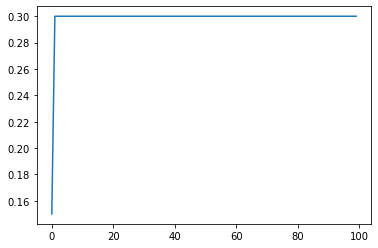

In [16]:
import matplotlib.pyplot as plt
import numpy as np

plt.plot(np.arange(100), np.linalg.norm(sol.u, axis=0))

In [9]:
from sympy import diff, linsolve, sqrt, symbols, Matrix, Symbol

def norm(x):
    return sqrt(x.T * x)

v_e = Symbol('v_e')
v, u, m = Matrix(symbols('vx vy vz')), Matrix(symbols('ux uy uz')), Symbol('m')
lr, lv, lm = Matrix(symbols('lx ly lz')), Matrix(symbols('lvx lvy lvz')), Symbol('lm')
H = lr.T * v + lv.T * u / m - lm * norm(u) / v_e + u.T * u / m
dH_du = diff(H, u)

In [18]:
from sympy import diff, linsolve, sqrt, symbols, Matrix, Symbol, MatrixSymbol
from sympy.vector import CoordSys3D

def norm(x):
    return sqrt(x.T * x)

R3 = CoordSys3D('R3')
v_e = Symbol('v_e')
v, u, m = MatrixSymbol('v', 3, 1), MatrixSymbol('u', 3, 1), Symbol('m')
lr, lv, lm = MatrixSymbol('lr', 3, 1), MatrixSymbol('lv', 3, 1), Symbol('lm')
H = lr.T * v + lv.T * u / m - lm * norm(u) / v_e + u.T * u / m
diff(H, u)

(2/m)*u + (-lm/v_e)*u*(u.T*u)**(-1/2) + 1/m*lv

In [9]:
sol.r

<Quantity [[ 1.30390659e+08,  1.30403249e+08,  1.30415836e+08,
             1.30428419e+08,  1.30440998e+08,  1.30453574e+08,
             1.30466145e+08,  1.30478713e+08,  1.30491277e+08,
             1.30503837e+08,  1.30516394e+08,  1.30528946e+08,
             1.30541495e+08,  1.30554040e+08,  1.30566581e+08,
             1.30579119e+08,  1.30591652e+08,  1.30604182e+08,
             1.30616708e+08,  1.30629230e+08,  1.30641748e+08,
             1.30654263e+08,  1.30666773e+08,  1.30679280e+08,
             1.30691783e+08,  1.30704282e+08,  1.30716778e+08,
             1.30729269e+08,  1.30741757e+08,  1.30754240e+08,
             1.30766720e+08,  1.30779196e+08,  1.30791669e+08,
             1.30804137e+08,  1.30816602e+08,  1.30829062e+08,
             1.30841519e+08,  1.30853972e+08,  1.30866422e+08,
             1.30878867e+08,  1.30891308e+08,  1.30903746e+08,
             1.30916180e+08,  1.30928610e+08,  1.30941036e+08,
             1.30953458e+08,  1.30965876e+08,  1.309782

In [15]:
from astropy.coordinates import CartesianRepresentation
from astropy.time import Time
from poliastro.plotting import OrbitPlotter3D

t = Time(Time.now(), scale='tdb')
plotter = OrbitPlotter3D(dark=True)
plotter.plot_body_orbit(Earth, t, trail=True)
plotter.plot_body_orbit(Mars, t + 300.0, trail=True)
plotter.plot_trajectory(CartesianRepresentation(sol.r), color='green', label='Trajectory')

In [145]:
from astropy.units import Unit

GM_SUN = 1.32712440018e20 * Unit('meter') ** 3 / Unit('second') ** 2.0

grav_param = Unit('m**3/s**2')

# Gravitational constant value from CODATA 2018- the last 2 sig figs are uncertain
BIG_G = 6.67430e-11 * grav_param / 'kg'

In [ ]:
(np.array(1.32712440018e20) / np.array(6.67430e-11)) * np.array(6.67430e-11)

1.32712440018e+20

In [2]:
pos = np.array([
    [0.0, 0.0, 0.0],
    [1.496e+11, 0.0, 0.0]
]) * Unit('m')
mass = np.array([1.989e30, 6.417e23]) * Unit('kg')

def compute_gravity(pos, mass) -> Quantity:
    diffs = pos - pos[..., None, :]         # [N, N, 3]
    dists = np.linalg.norm(diffs, axis=-1)  # [N, N]

    # Mask out non-existent gravitational attractions of objects to themselves, which would
    # otherwise cause a divide by zero error (since the distance is 0)
    np.fill_diagonal(dists, np.inf)
    return BIG_G * np.sum(mass[None, :, None] * diffs / dists[..., None] ** 3, axis=-2)  # [N, 3]

compute_gravity(pos, mass)

NameError: name 'np' is not defined

In [5]:
from astropy.units import Unit
from pathfinder import State
import numpy as np

system = np.stack([
    State.get_body('Sun'),
    State.get_body('Venus'),
    State.get_body('Earth'),
    State.get_body('Mars')
    # State.get_body('Jupiter')
])
system = State(system)
system.compute_gravity()

<Quantity [[-1.13233894e-08, -2.73879691e-08, -1.07050228e-08],
           [ 9.06867066e-03,  6.41819534e-03,  2.31412980e-03],
           [-3.84377872e-03,  3.93701769e-03,  1.70670256e-03],
           [ 2.07789398e-03, -4.53050424e-04, -2.63872296e-04]] m / s2>

In [14]:
import torch

SECS_PER_YEAR = 31_556_952
SECS_PER_WEEK = 604_800

result = system.evolve(torch.arange(0.0, SECS_PER_YEAR * 20, step=SECS_PER_WEEK))